<a href="https://colab.research.google.com/github/JaladiRishitha/U-Net_GI-tract-segmentation/blob/main/preprocessing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install SimpleITK

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.7/52.7 MB 19.1 MB/s eta 0:00:00


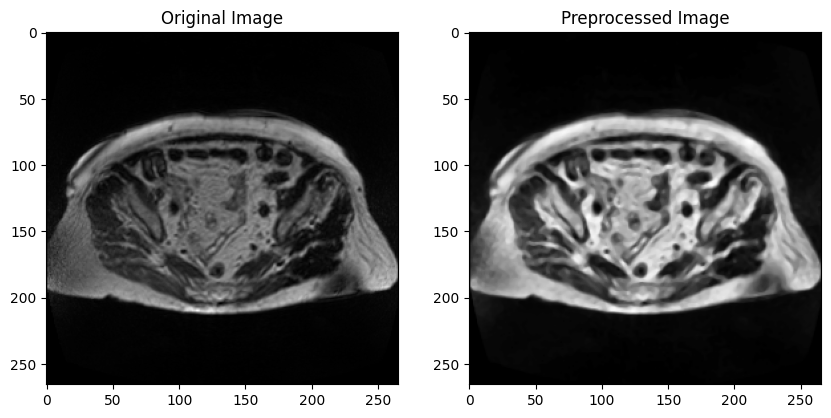

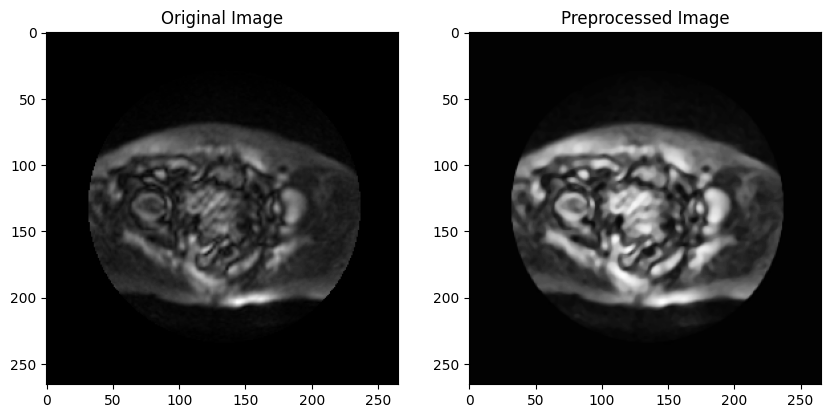

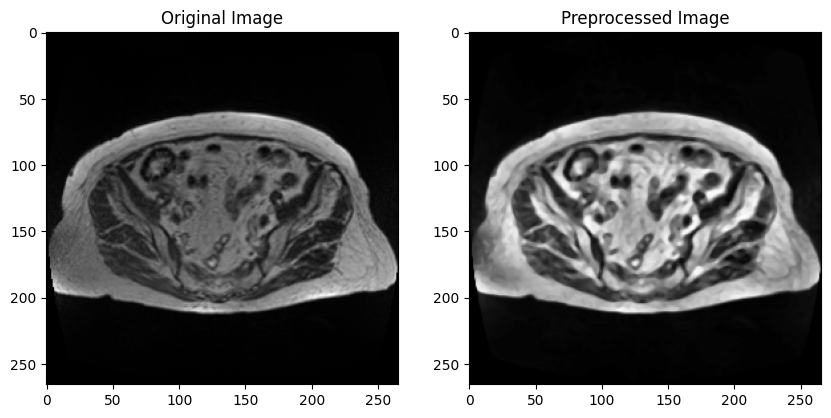

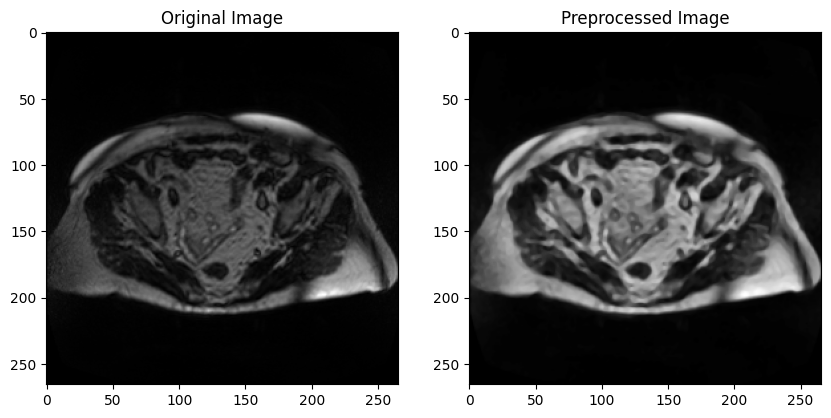

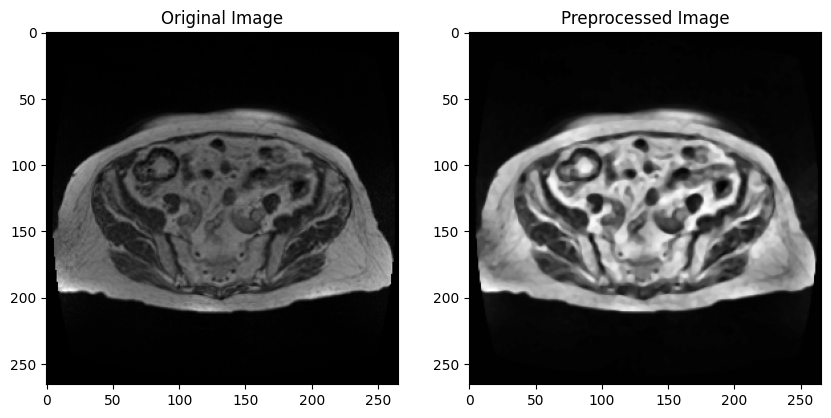

...

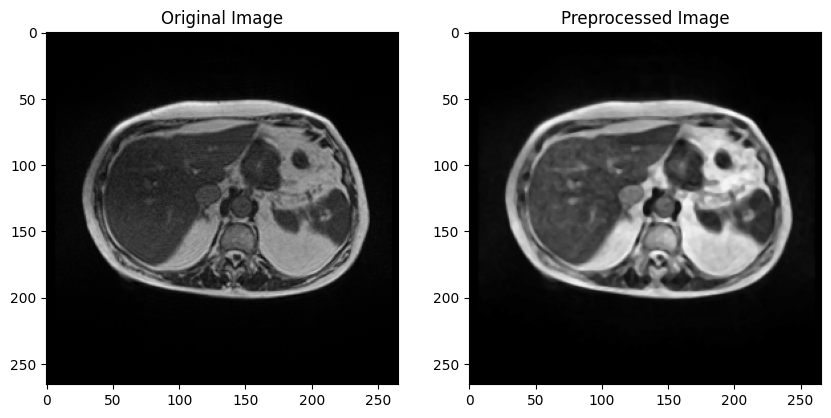

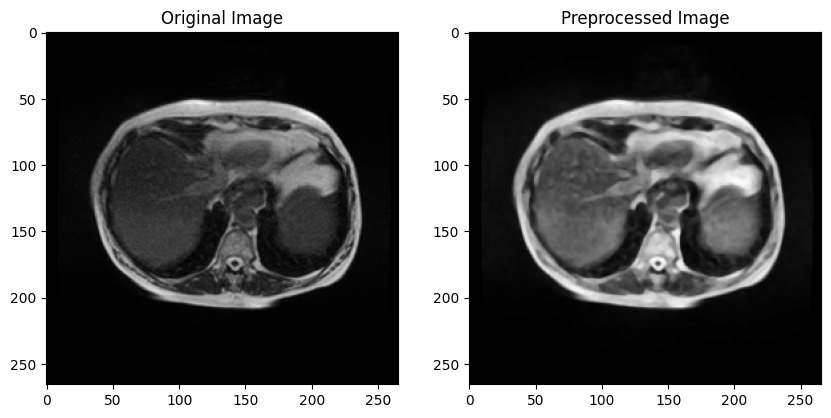

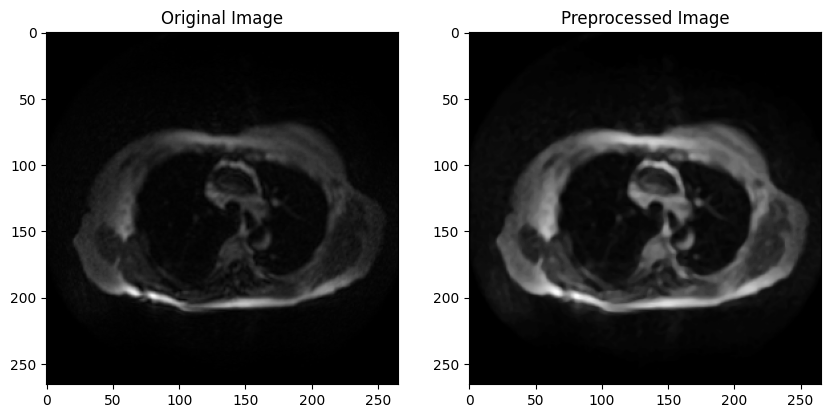

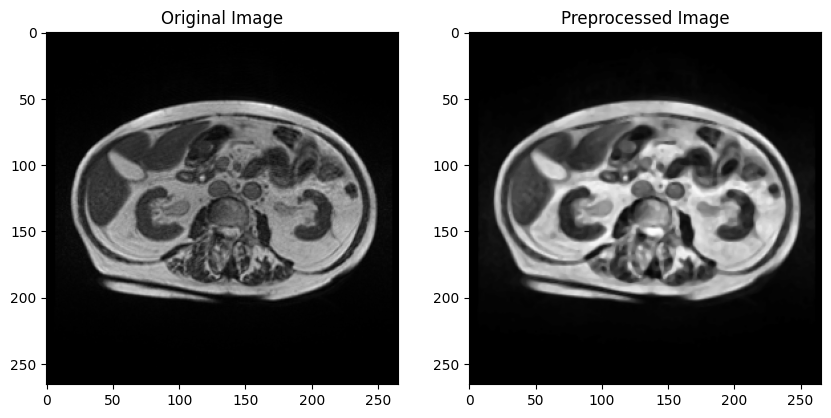

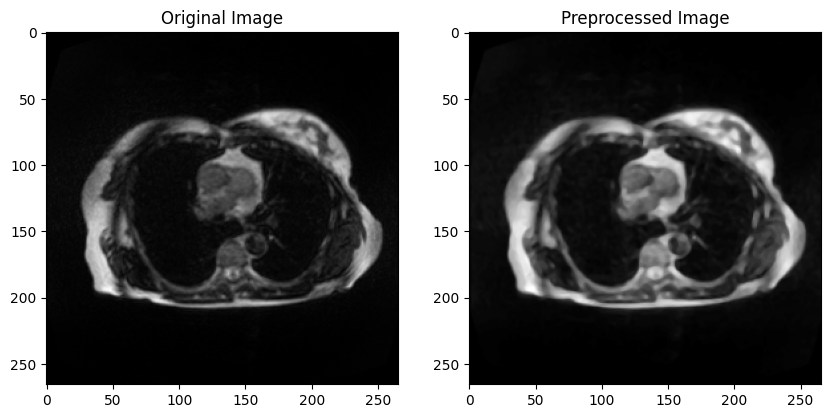

In [ ]:

import os
import SimpleITK as sitk
import matplotlib.pyplot as plt
from scipy.ndimage import median_filter
from skimage import exposure, img_as_float
import shutil
import numpy as np

input_dir = "/content/drive/MyDrive/train_test2/train/case2/case2_day1/scans"
output_dir = "/content/drive/MyDrive/train_test3/train/case2/case2_day1/scans"
# Create the output folder if it doesn't exist
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Process each image in the input directory
for filename in os.listdir(input_dir):

    # Read input image
    input_path = os.path.join(input_dir, filename)
    input_image = sitk.ReadImage(input_path)

    # Convert input image to 32-bit float
    input_image = sitk.Cast(input_image, sitk.sitkFloat32)

    # Step 1: Bias correction
    corrected_image = sitk.N4BiasFieldCorrection(input_image)
    #corrected_image = sitk.N4BiasFieldCorrection(input_image)

    # Step 2: Histogram equalization
    # Convert SimpleITK image to NumPy array and scale intensities between 0 and 1
    img = sitk.GetArrayFromImage(corrected_image)
    img = img / np.max(img)

    # Perform adaptive histogram equalization with a contrast limit of 0.01
    img_eq = exposure.equalize_adapthist(img, clip_limit=0.01)

    # Convert the equalized image back to a SimpleITK image
    eq_image = sitk.GetImageFromArray(img_eq)

    # Step 3: Median filtering
    def median_filter_image(image, size=3):
        # Convert image to NumPy array, apply median filter, and convert back to SimpleITK image
        return sitk.GetImageFromArray(median_filter(sitk.GetArrayFromImage(image), size=size))

    median_filtered_image = median_filter_image(eq_image, size=3)

    # Step 4: smoothing
    smoothed_image = sitk.CurvatureFlow(median_filtered_image, numberOfIterations=5, timeStep=0.125)

    # Step 5: Intensity normalization
    normalized_image = sitk.Normalize(smoothed_image)

    # Convert normalized image to unsigned char
    normalized_image = sitk.Cast(sitk.RescaleIntensity(normalized_image), sitk.sitkUInt8)

    # Save preprocessed image to output directory
    output_path = os.path.join(output_dir, filename)
    sitk.WriteImage(normalized_image, output_path)

    # Display original and preprocessed images
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    axs[0].imshow(sitk.GetArrayFromImage(input_image), cmap='gray')
    axs[0].set_title('Original Image')
    axs[1].imshow(sitk.GetArrayFromImage(normalized_image), cmap='gray')
    axs[1].set_title('Preprocessed Image')
    plt.show()

# Copy the preprocessed images to the output directory
for root, dirs, files in os.walk(input_dir):
    for file_name in files:
        if file_name.endswith(".png"):
            src_path = os.path.join(root, file_name)
            dst_path = src_path.replace(input_dir, output_dir)
            os.makedirs(os.path.dirname(dst_path), exist_ok=True)
            shutil.copy2(src_path, dst_path)
